# Extract spectra from ASKAP cube based on the ASKAP continuum catalogue 

In [34]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from astropy import units as u
from astropy.coordinates import SkyCoord, EarthLocation
from astropy.io import fits
from spectral_cube import SpectralCube
from spectral_cube import BooleanArrayMask
from astropy.convolution import Gaussian1DKernel, convolve
import aplpy  
from astropy.wcs import WCS
from reproject import reproject_interp
from astroquery.vizier import Vizier
from astroquery.skyview import SkyView
from astropy.time import Time
import csv
from astropy.io import ascii
import pandas as pd

Vizier.ROW_LIMIT = -1

mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['font.size'] = '16'
mpl.rcParams['xtick.direction'] = 'in'
mpl.rcParams['ytick.direction'] = 'in'
%matplotlib inline

In [36]:
# read in ASKAP data cube

cube_askap = SpectralCube.read('/Users/denes/Research/high_lat_HI/ASKAP_data/Karens_test_v2/Hydra_MW.fits')  # Open the FITS file for reading
askap = fits.open('/Users/denes/Research/high_lat_HI/ASKAP_data/Karens_test_v2/Hydra_MW.fits')  # Open the FITS file for reading
d_askap = askap[0].data
h_askap = askap[0].header
w_askap = WCS(h_askap, askap)

askap_cont = fits.open('/Users/denes/Research/High_lat_HI/ASKAP_data/continuum_data/Hydra_cont.fits')  # Open the FITS file for reading
d_askap_cont = askap_cont[0].data
h_askap_cont = askap_cont[0].header
w_askap_cont = WCS(h_askap_cont, askap_cont)

coordinate = '{}{}'.format(h_askap['CRVAL1'], h_askap['CRVAL2'])
c = SkyCoord(coordinate, unit=(u.deg, u.deg))
print(c)

MRO = EarthLocation.of_site('mro') 
barycorr = c.radial_velocity_correction(obstime=Time('2019-10-25'), location=MRO) 
restfreq = 1.420405752 * u.GHz  # rest frequency of HI
freq_to_vel = u.doppler_optical(restfreq) # using the radio convention
vel_askap = (cube_askap.spectral_axis).to(u.km / u.s, equivalencies=freq_to_vel) #- barycorr/2

print(c.galactic.l.deg)

<SkyCoord (ICRS): (ra, dec) in deg
    (153.94930833, -27.37438056)>
265.33296713150395


In [4]:
print(d_askap.shape)

(270, 1, 4741, 7753)


In [29]:
# read in ASKAP catalogue

data_1 = pd.read_csv('/Users/denes/Research/high_lat_HI/ASKAP_data/continuum_cat/AS102_Continuum_Island_Catalogue_10609_119.csv')
data_2 = pd.read_csv('/Users/denes/Research/high_lat_HI/ASKAP_data/continuum_cat/AS102_Continuum_Island_Catalogue_10612_123.csv')

df_1 = pd.DataFrame(data_1)
df_2 = pd.DataFrame(data_2)

# concatenate catalogues
df = pd.concat([df_1, df_2])

print(data_1.keys())

Index(['id', 'catalogue_id', 'other_sbids', 'first_sbid', 'project_id',
       'island_id', 'island_name', 'n_components', 'ra_hms_cont',
       'dec_dms_cont', 'ra_deg_cont', 'dec_deg_cont', 'freq', 'maj_axis',
       'min_axis', 'pos_ang', 'flux_int', 'flux_int_err', 'flux_peak',
       'mean_background', 'background_noise', 'max_residual', 'min_residual',
       'mean_residual', 'rms_residual', 'stddev_residual', 'x_min', 'x_max',
       'y_min', 'y_max', 'n_pix', 'solid_angle', 'beam_area', 'x_ave', 'y_ave',
       'x_cen', 'y_cen', 'x_peak', 'y_peak', 'flag_i1', 'flag_i2', 'flag_i3',
       'flag_i4', 'comment', 'quality_level', 'released_date'],
      dtype='object')


In [24]:
# do a cut on the catalog

sources = df[df['flux_peak']>15]
print(len(sources))

678


In [25]:
ra = np.array(sources['ra_hms_cont'])
dec = np.array(sources['dec_dms_cont'])
n_pix = np.array(sources['n_pix'])
print(len(ra))

678


/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/index

4 sigma detections: 82


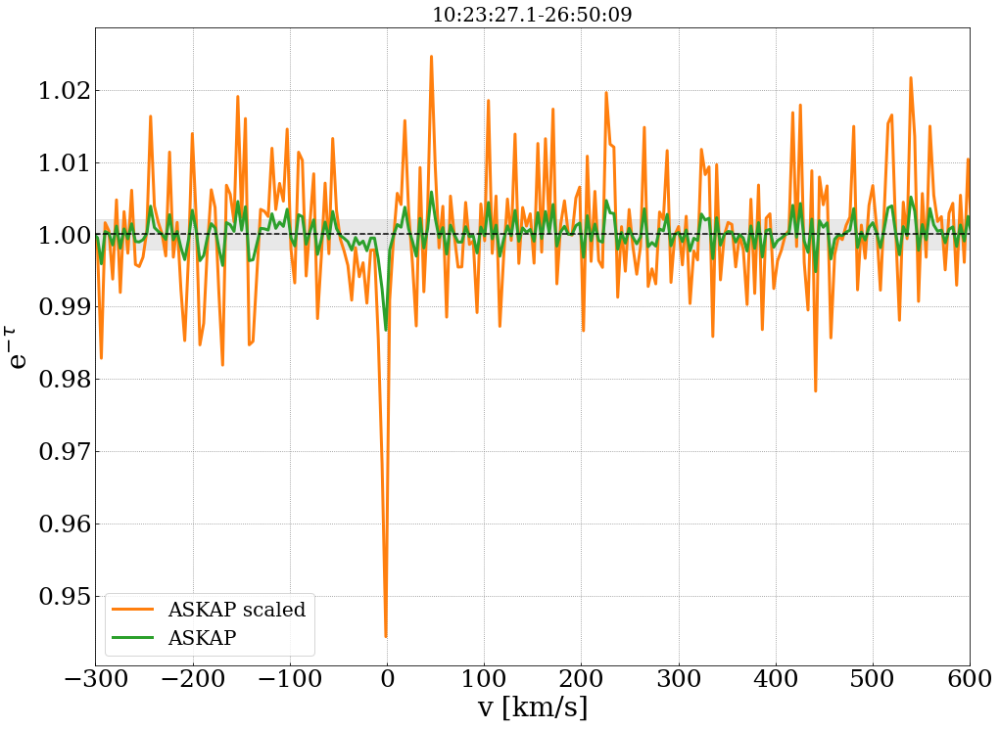

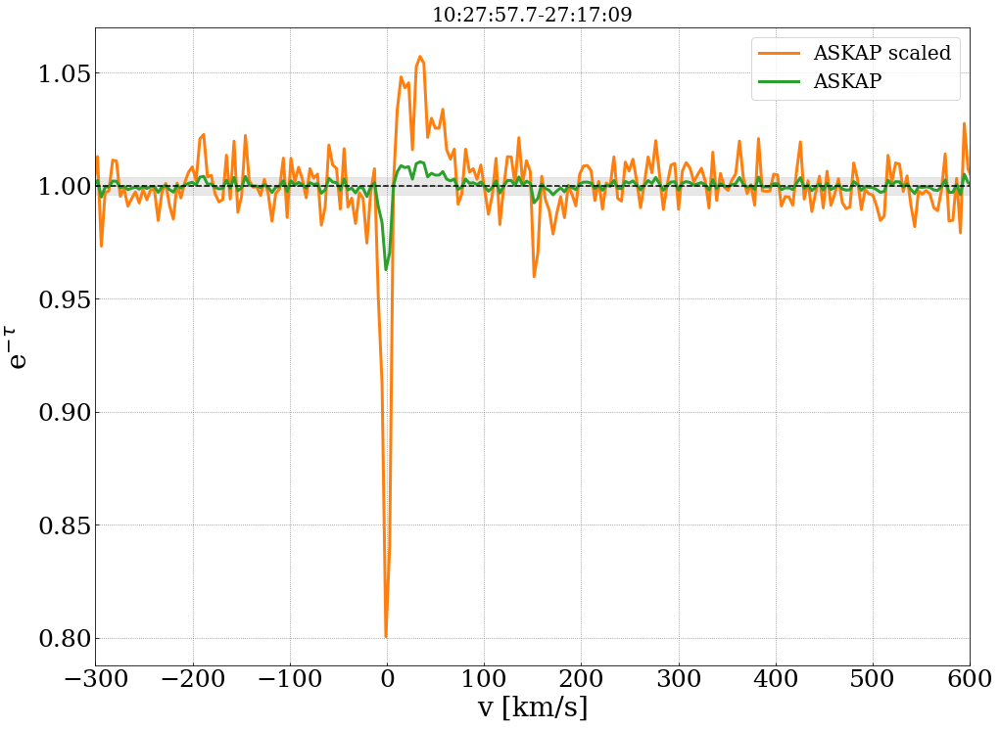

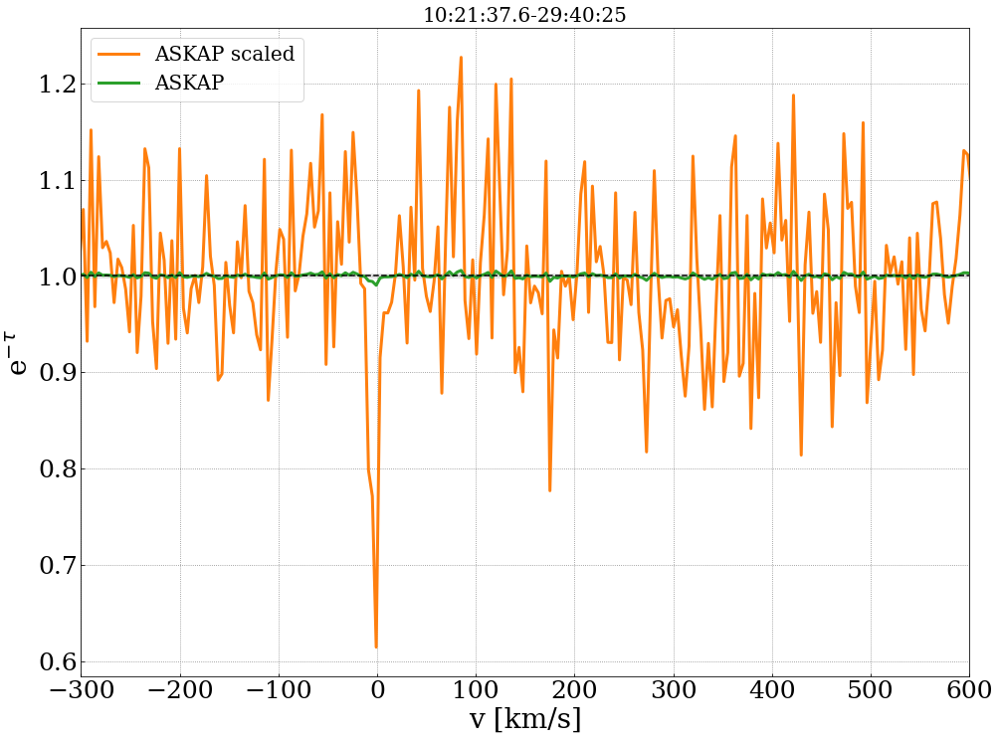

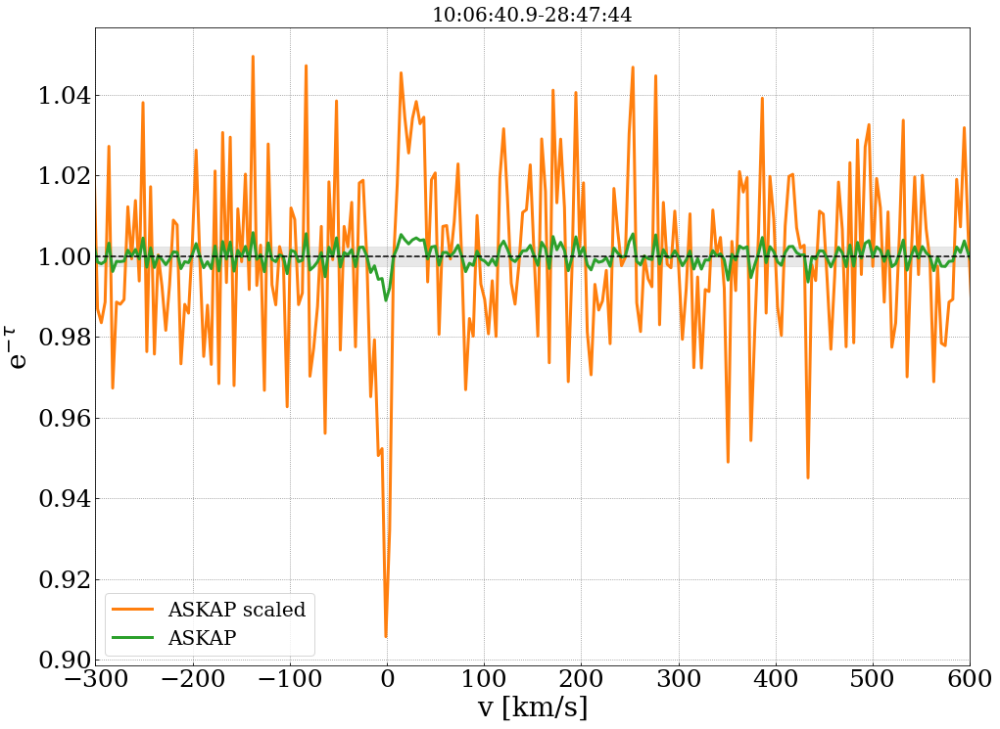

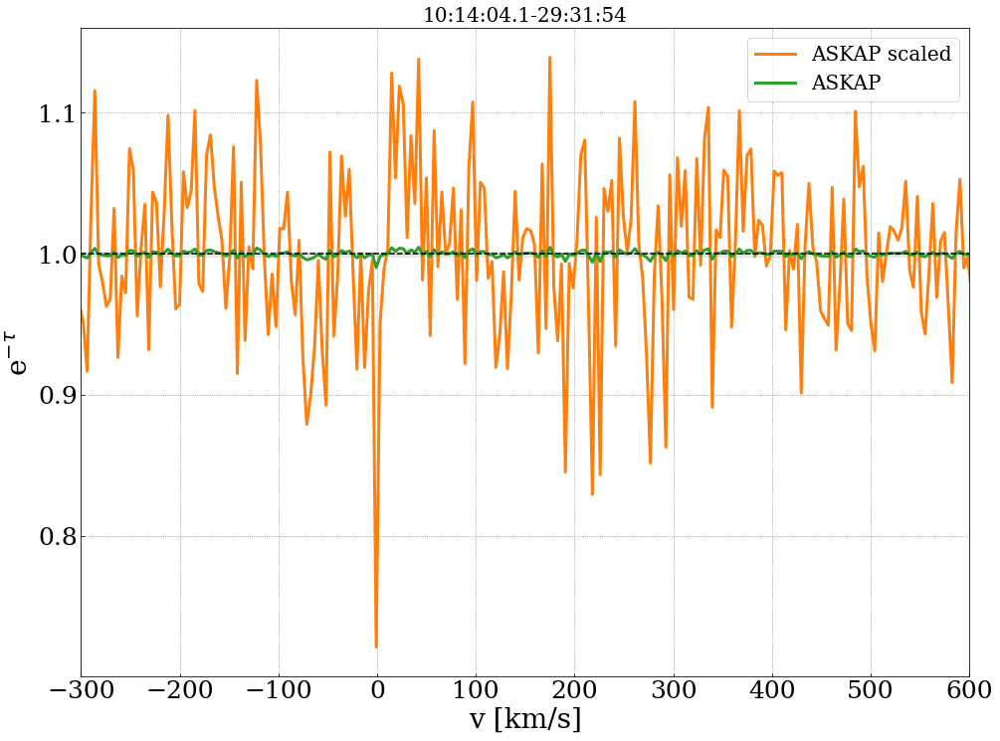

...

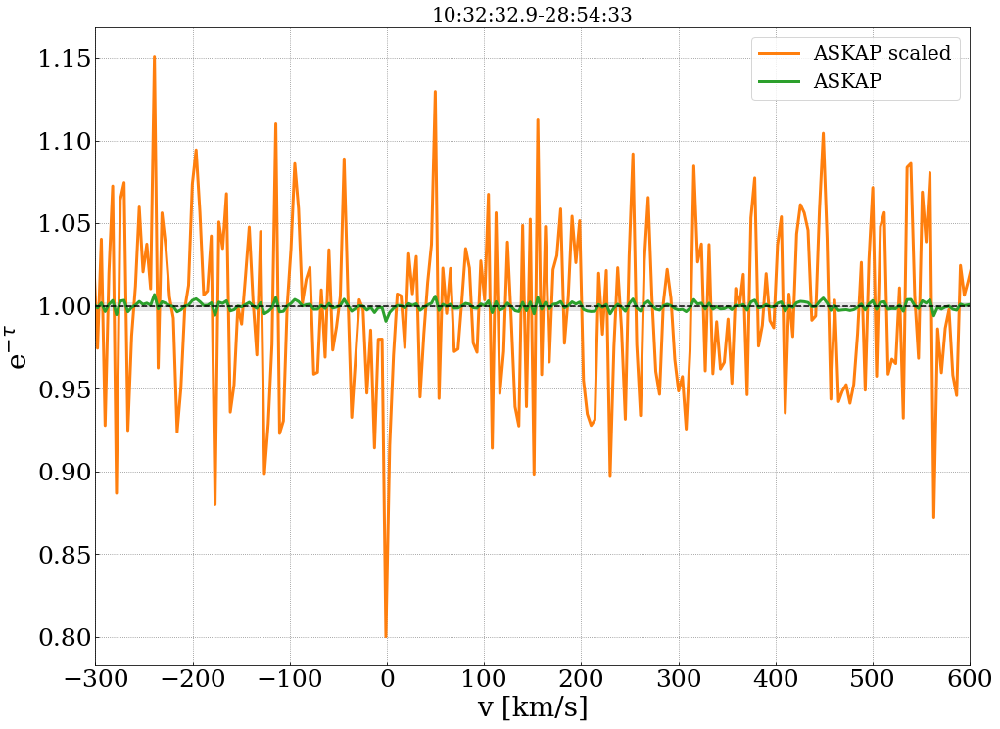

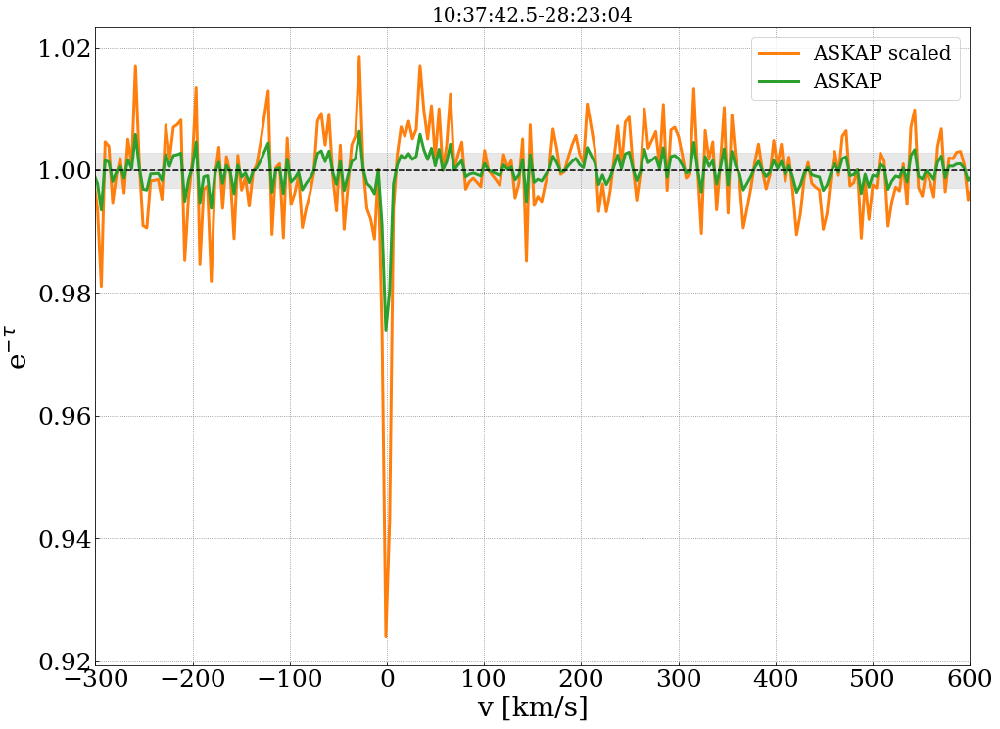

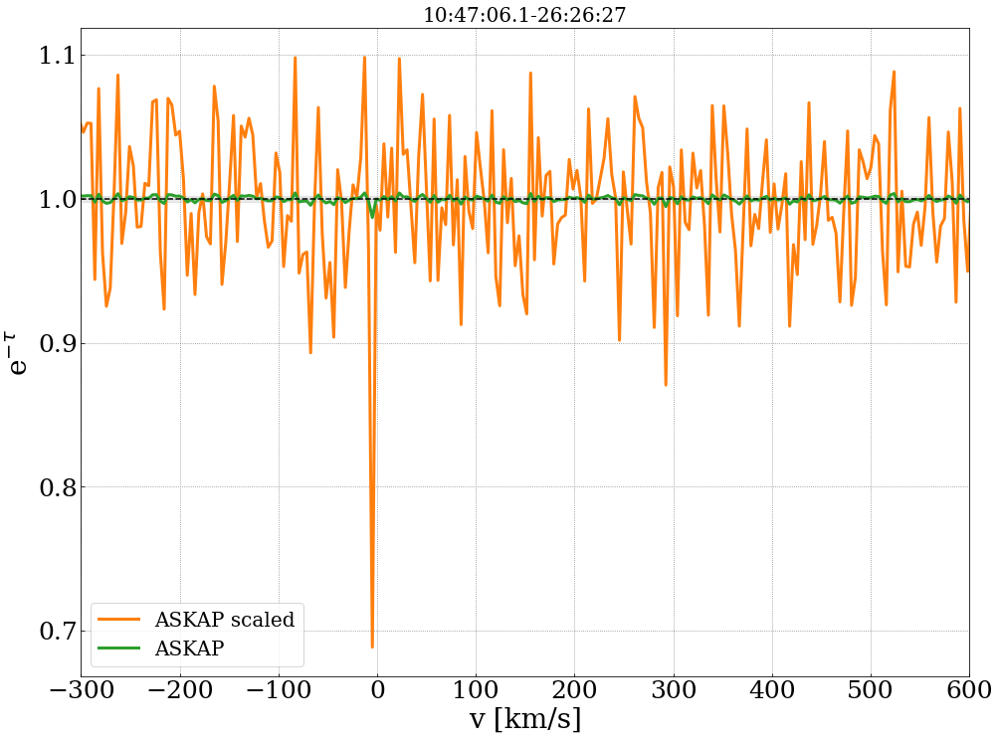

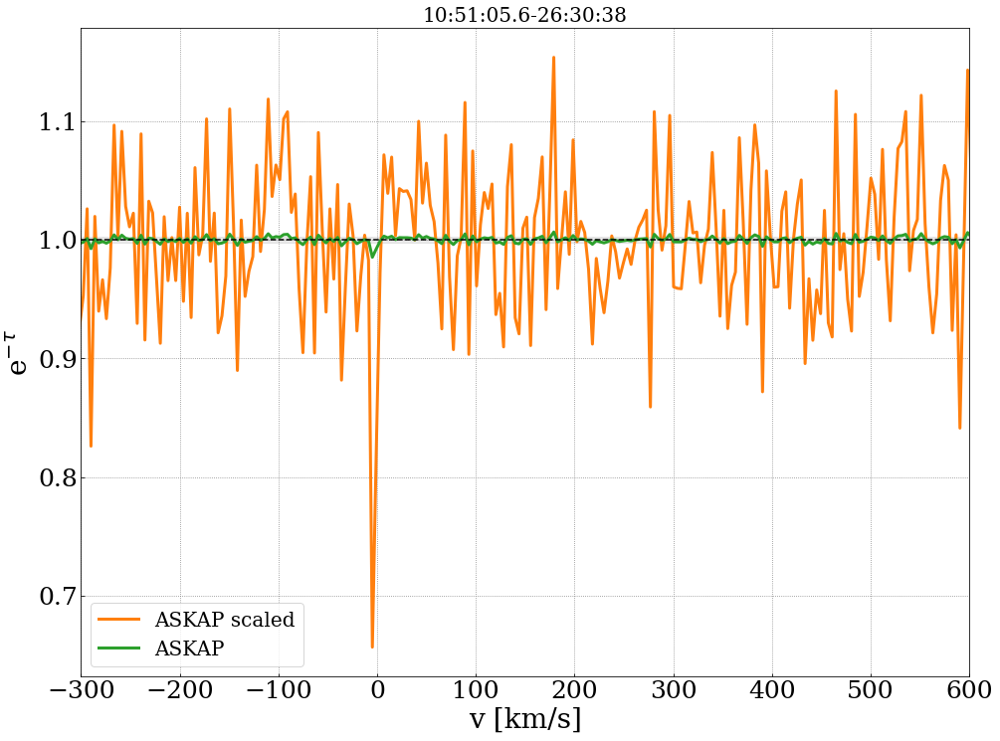

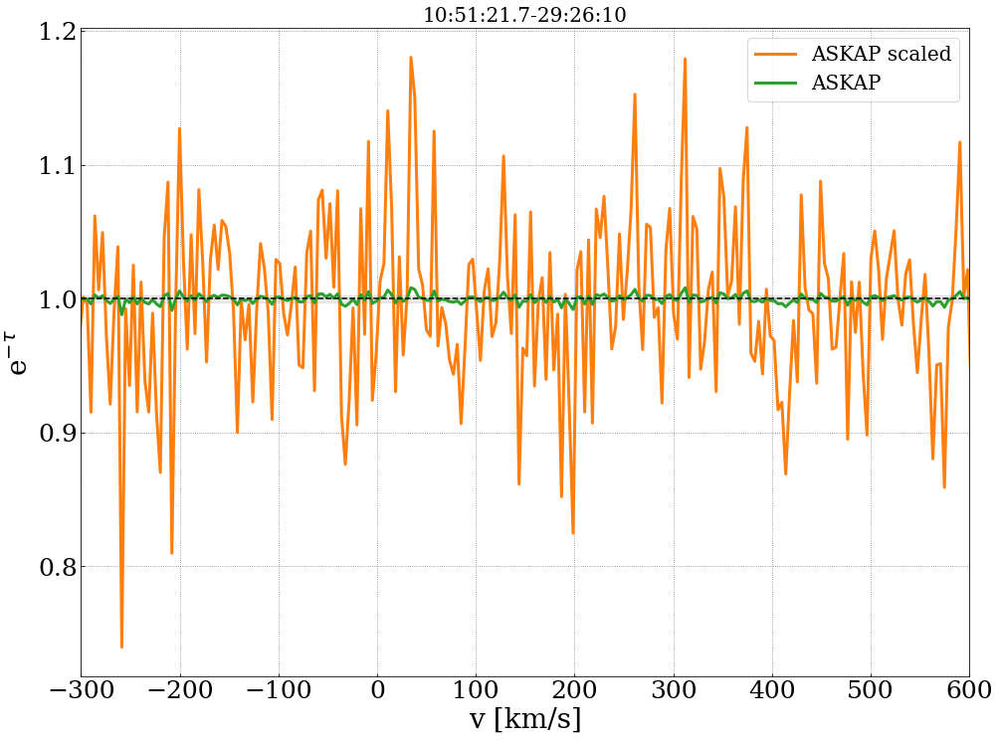

In [28]:
# extract spectra
# filter for S/N
# make plots

detection = []
rms_abs = []
tau_max = []

#for i in range(len(sources)):
for i in range(2):
    coord = '{} {}'.format(ra[i], dec[i])
    c2 = SkyCoord(coord, unit=(u.hourangle, u.deg))
    pixels_askap = c2.to_pixel(w_askap)
    pixels_askap_cont = c2.to_pixel(w_askap_cont)
    #print(coord )
    #print(pixels_askap)

    spectrum_askap = cube_askap[:, int(pixels_askap[1]), int(pixels_askap[0])]  # 10:09:10 -28:55:57
    spectrum_askap_cor = (spectrum_askap.value+continuum_askap)/continuum_askap
    tau_askap = np.log(spectrum_askap.value +1) * -1.
    rms = np.sqrt(np.mean(spectrum_askap.value**2))
    rms_abs.append(rms)
    tau_max.append(abs(np.min(spectrum_askap.value)))
    
    
    continuum_askap = d_askap_cont[int(pixels_askap_cont[1]), int(pixels_askap_cont[0])]
    
    if abs(np.min(spectrum_askap.value)) > rms*4:
        detection.append(i)

        # plot
        fig = plt.figure(figsize=(16, 12))
        ax = fig.add_subplot(111)
        ax.set_title('{}{}'.format(ra[i], dec[i]), fontsize=20)

        plt.plot(vel_askap, (spectrum_askap.value+continuum_askap)/continuum_askap, 'C1', linewidth=3, label='ASKAP scaled')
        plt.plot(vel_askap, spectrum_askap.value+1, 'C2', linewidth=3, label='ASKAP')
        ax.axhspan(1-rms, 1+rms, alpha=0.5, color='lightgrey')
        #plt.title('102809-264418', fontsize=30)
        plt.ylabel(r'e$^{-\tau}$', fontsize=28)
        plt.xlabel("v [km/s]", fontsize=28)
        plt.xlim(-300,600)
        #plt.ylim(0.92,1.02)
        plt.axhline(1, color='k', linestyle='--')
        plt.legend(fontsize=20)
        ax.tick_params(axis='both', which='major', labelsize=25)
        fig.savefig('./spectra_plots/{}{}_ASKAP_spectra_test.png'.format(ra[i].replace(':',''), dec[i].replace(':','')))
        
        df_spectra = pd.DataFrame()
        df_spectra['velocity'] = vel_askap
        df_spectra['Amplitude'] = (spectrum_askap.value+continuum_askap)/continuum_askap
        df_spectra.to_csv('./spectra/{}{}_askap_spectrum.txt'.format(ra[i].replace(':',''), dec[i].replace(':','')), sep='\t')
        

sources['rms_abs'] = rms_abs   
sources['tau_max'] = tau_max
print('4 sigma detections:', len(detection))    

In [27]:
sources_good_5 = sources[sources['tau_max'] > sources['rms_abs']*5]
sources_good_5.to_csv('./5_sigma_askap_sources.csv')


# Plot 4 sigma detections onto cube

In [ ]:
# make fancy HI overlay plots

# read in HI data
hi_data = fits.open('/Users/denes/Research/high_lat_HI/ASKAP_data/large_cube_mom_0_-10-10kms.fits')  # Open the FITS file for reading
#hi_data = fits.open('/Users/denes/Research/high_lat_HI/ASKAP_data/large_cube_mom_0_140-160kms.fits')  # Open the FITS file for reading
d = hi_data[0].data
h = hi_data[0].header

# read in CO data
co_data = fits.open('/Users/denes/Research/high_lat_HI/Planck_CO/Rep_Lon264.69deg-Lat23.29deg_15deg_COM_CompMap_CO21-commander_2048_R2.00_v2.fits')  # Open the FITS file for reading
d2 = co_data[1].data
h2 = co_data[1].header

co_reprojected, footprint = reproject_interp(co_data[1], h)

# select continuum sources to plot
sources_good = sources[sources['tau_max'] > sources['rms_abs']*4]
ra_4sig = np.array(sources_good['ra_hms_cont'])
dec_4sig = np.array(sources_good['dec_dms_cont'])

sources_good_5 = sources[sources['tau_max'] > sources['rms_abs']*5]
ra_5sig = np.array(sources_good_5['ra_hms_cont'])
dec_5sig = np.array(sources_good_5['dec_dms_cont'])
print(len(ra))

atca_sources = ['10:28:09.68 -26:44:18.9', '10:19:08.52 -27:08:56.5', '10:22:29.45 -26:47:34.3']

# plot figure
fig = plt.figure(figsize=(14, 7))
ax = fig.add_subplot(111, projection=WCS(h))

# Display the moment map image
im = ax.imshow(d, cmap='viridis', vmin=-0.1, vmax=0.1)
ax.contour(co_reprojected, levels=[0.4, 0.8], cmap='Blues_r', alpha=0.7)

x_lim = ax.get_xlim()
y_lim = ax.get_ylim()

for i in range(0, len(ra)):
    coord = '{} {}'.format(ra[i], dec[i])
    c_0 = SkyCoord(coord, unit=(u.hourangle, u.deg))
    ax.scatter(c_0.ra, c_0.dec, transform=ax.get_transform('fk5'), marker='x', s=100, edgecolor='k', linewidth=2, facecolor='k', alpha=0.7)


for i in range(0, len(ra_4sig)):
    coord = '{} {}'.format(ra_4sig[i], dec_4sig[i])
    c = SkyCoord(coord, unit=(u.hourangle, u.deg))
    ax.scatter(c.ra, c.dec, transform=ax.get_transform('fk5'), marker='x', s=100, edgecolor='k', linewidth=2, facecolor='k')

for i in range(0, len(ra_5sig)):
    coord = '{} {}'.format(ra_5sig[i], dec_5sig[i])
    c2 = SkyCoord(coord, unit=(u.hourangle, u.deg))
    ax.scatter(c2.ra, c2.dec, transform=ax.get_transform('fk5'), marker='x', s=100, edgecolor='r', linewidth=2, facecolor='red')

for j in range(0, len(atca_sources)):
    c3 = SkyCoord(atca_sources[j], unit=(u.hourangle, u.deg))
    ax.scatter(c3.ra, c3.dec, transform=ax.get_transform('fk5'), marker='<', s=100, edgecolor='k', linewidth=2, facecolor='none')
    #ax.text(c3.ra.value, c3.dec.value, transform=ax.get_transform('fk5'),s=sources[j],fontsize=10)


#ax.set_title('Hydra', fontsize=22)
ax.tick_params(axis='both', which='major', labelsize=18)
ax.coords['ra'].set_axislabel('RA (J2000)', fontsize=22)
ax.coords['dec'].set_axislabel('Dec (J2000)', fontsize=22)
cbar_hi = plt.colorbar(im, orientation='vertical', fraction=0.022, pad=0.12)
#cbar_hi.set_label('NHI', size=18)

overlay = ax.get_coords_overlay('galactic')
overlay.grid(color='k', ls='dotted')
overlay[0].set_axislabel('Galactic Longitude',fontsize=22)
overlay[1].set_axislabel('Galactic Latitude',fontsize=22)

ax.set_xlim(x_lim)
ax.set_ylim(y_lim)

#plt.colorbar(im)
fig.savefig('Hydra_CO_ASKAP_overlay_5sig_abs_v2.png',dpi=200)

In [ ]:
d_askap.shape

In [ ]:
fig = plt.figure(figsize=(16, 12))
ax = fig.add_subplot(111)
plt.scatter(sources_good['tau_max'], sources_good['flux_peak'], marker='o', color='C1')        
plt.ylabel(r'F$_{peak}$', fontsize=28)
plt.xlabel(r"$\tau_{max}$", fontsize=28)
#plt.xlim(-200,200)
#plt.ylim(0,10)
#plt.axhline(4, color='k', linestyle='--')
#plt.legend(fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=25)
fig.savefig('./tau_peak_flux_ASKAP.png', dpi=100, bbox_inches="tight")

fig = plt.figure(figsize=(16, 12))
ax = fig.add_subplot(111)
plt.scatter(sources_good['tau_max'], sources_good['flux_int'], marker='o', color='C1')        
plt.ylabel(r'F$_{int}$', fontsize=28)
plt.xlabel(r"$\tau_{max}$", fontsize=28)
#plt.xlim(-200,200)
#plt.ylim(0,10)
#plt.axhline(4, color='k', linestyle='--')
#plt.legend(fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=25)
fig.savefig('./tau_int_flux_ASKAP.png', dpi=100, bbox_inches="tight")



In [ ]:
fig = plt.figure(figsize=(6.,5.))
plt.axes(frameon=False)
plt.xticks([])
plt.yticks([])

ax = fig.add_subplot(1,1,1)
d = sources_good['flux_peak']
bin_size = range(0,1500,100) 
plt.hist(d, bins=bin_size, histtype='step', color='C0', fill=True, linewidth=2)
plt.xticks(family='serif',size=18)
plt.yticks(family='serif',size=18)
#ax.set_ybound(0, 20)
ax.set_xlabel(r'F$_{peak}$ [mJy]', size=20,family='serif')
ax.set_ylabel('N', size=20,family='serif')

plt.tight_layout()
plt.savefig('f_peak_histogram.png')

fig = plt.figure(figsize=(6.,5.))
plt.axes(frameon=False)
plt.xticks([])
plt.yticks([])

ax = fig.add_subplot(1,1,1)
d = sources_good['flux_int']
bin_size = range(0,1500,100) 
plt.hist(d, bins=bin_size, histtype='step', color='C0', fill=True, linewidth=2)
plt.xticks(family='serif',size=18)
plt.yticks(family='serif',size=18)
#ax.set_ybound(0, 20)
ax.set_xlabel(r'F$_{int}$ [mJy]', size=20,family='serif')
ax.set_ylabel('N', size=20,family='serif')

plt.tight_layout()
plt.savefig('f_int_histogram.png')

fig = plt.figure(figsize=(6.,5.))
plt.axes(frameon=False)
plt.xticks([])
plt.yticks([])

ax = fig.add_subplot(1,1,1)
d = sources_good['maj_axis']
print(np.max(d), np.min(d))
bin_size = range(0,100,5) 
plt.hist(d, bins=bin_size, histtype='step', color='C0', fill=True, linewidth=2)
plt.xticks(family='serif',size=18)
plt.yticks(family='serif',size=18)
#ax.set_ybound(0, 20)
ax.set_xlabel(r'axis$_{maj}$', size=20,family='serif')
ax.set_ylabel('N', size=20,family='serif')

plt.tight_layout()
plt.savefig('maj_axis_histogram.png')

# testing

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:57: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


4 sigma detections: 18


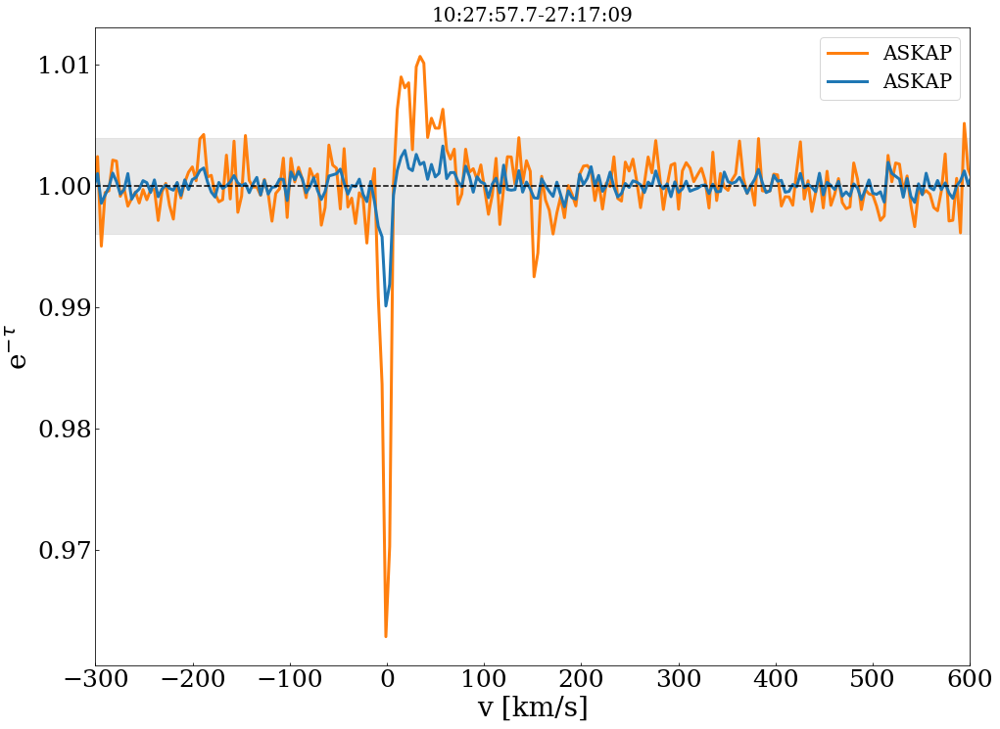

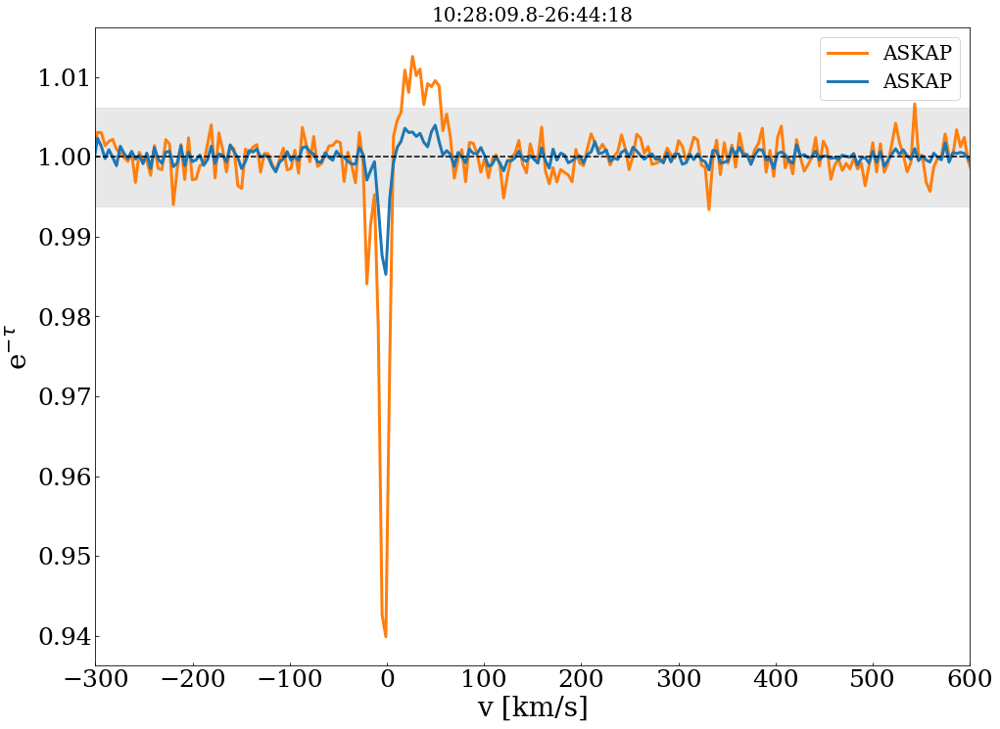

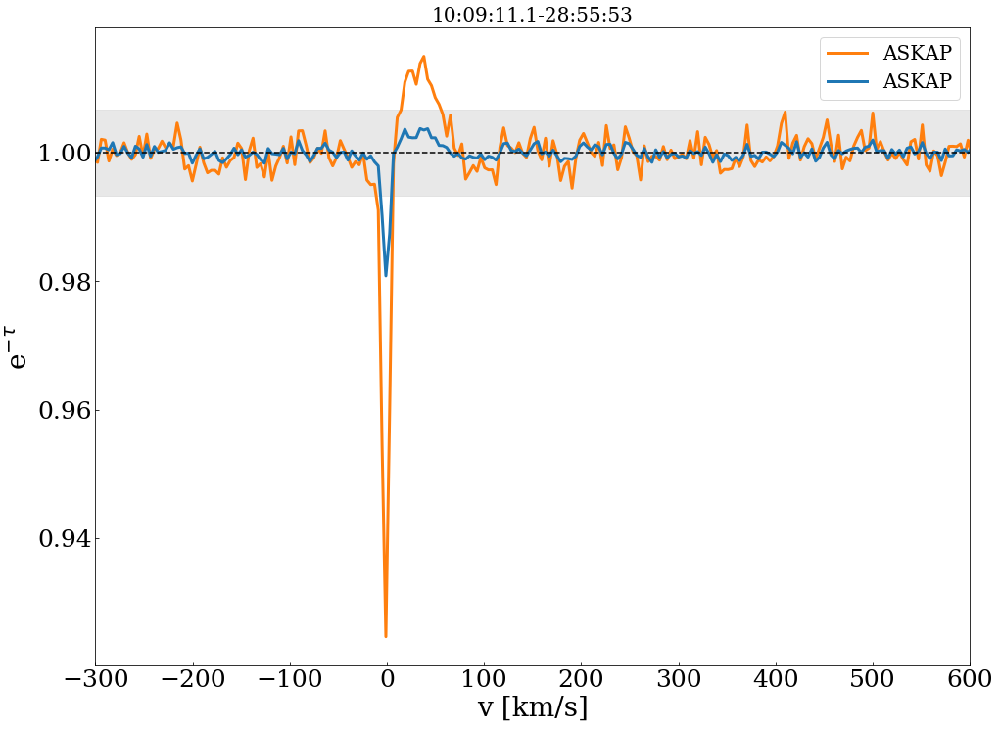

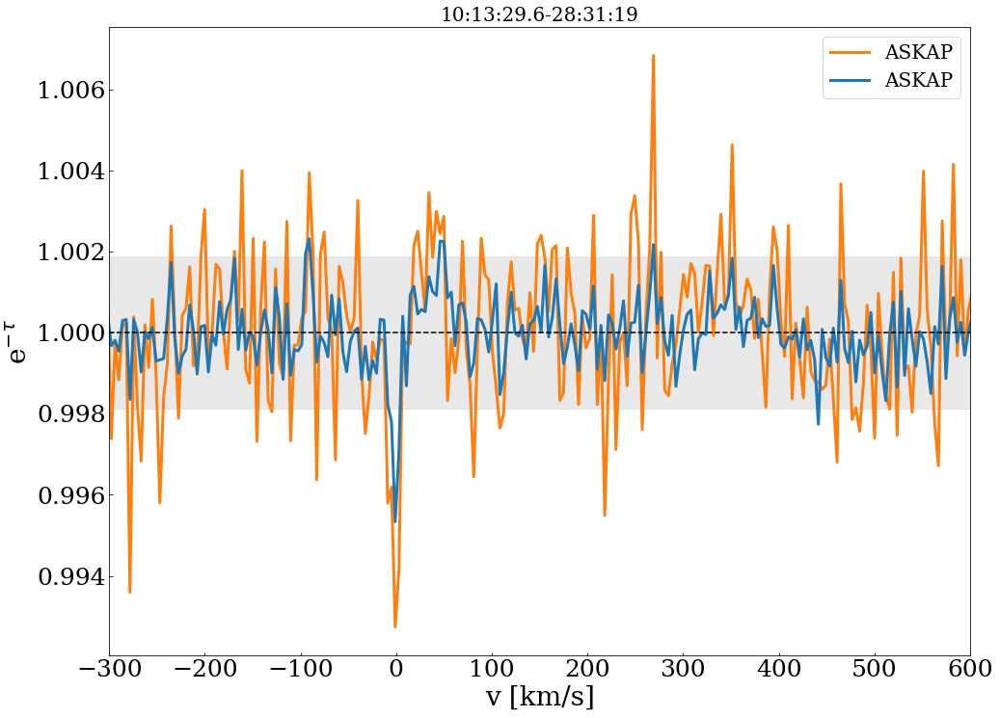

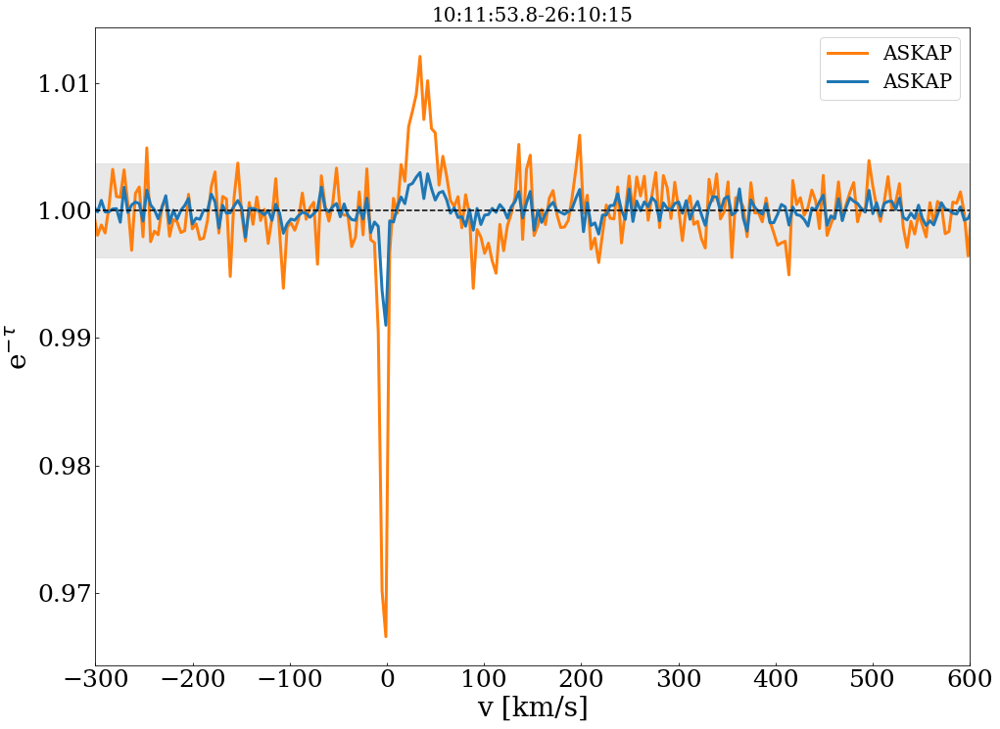

...

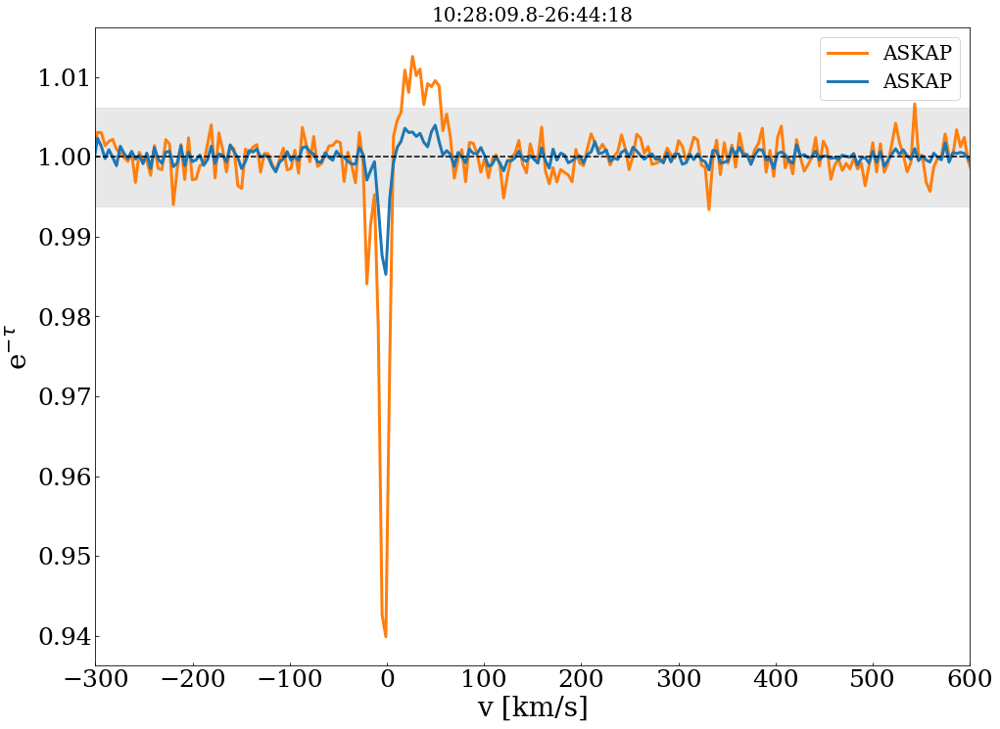

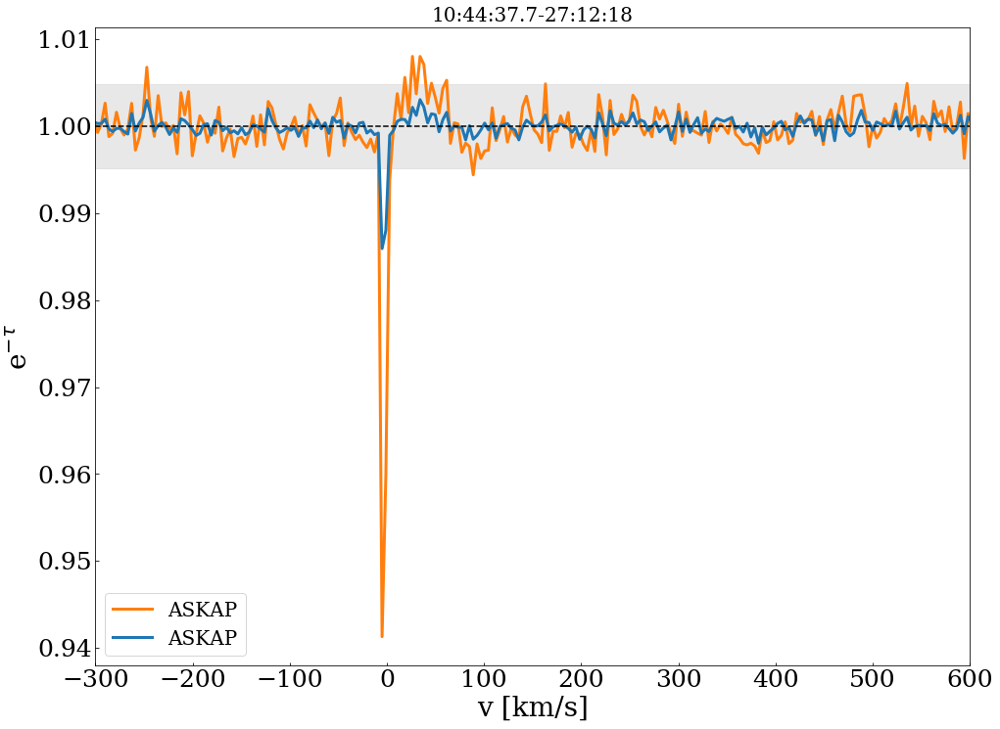

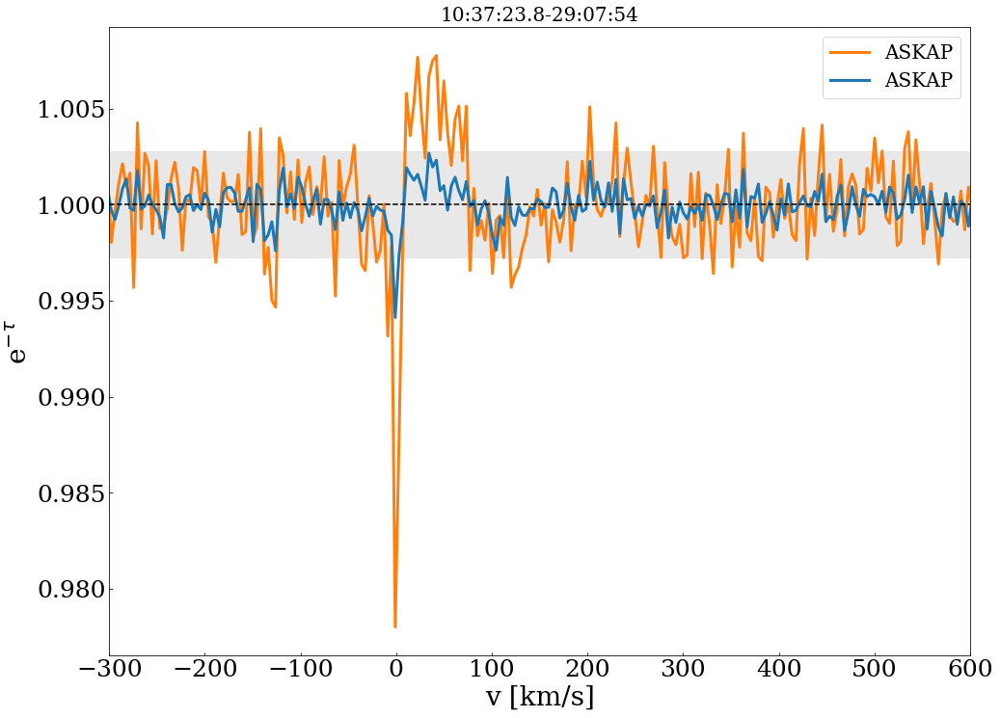

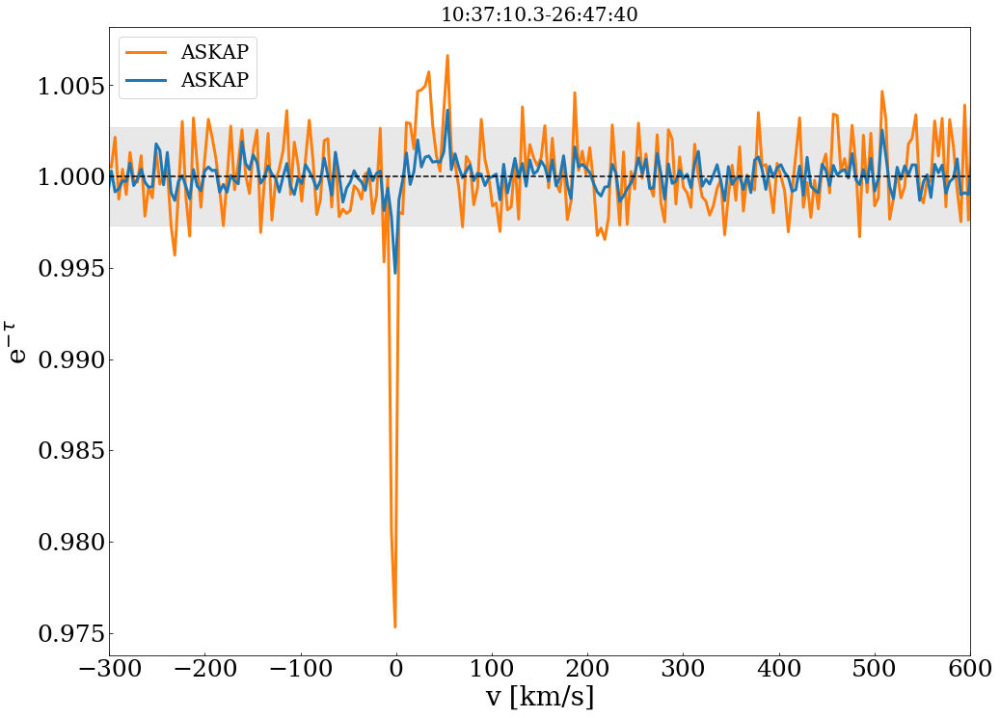

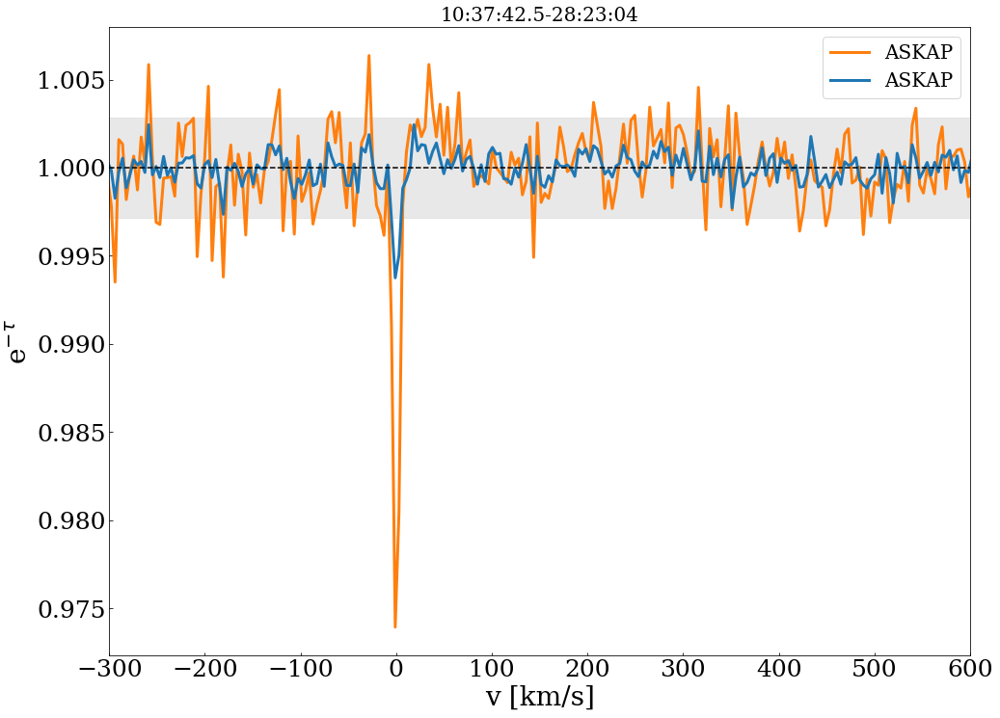

In [17]:
# extract spectra, average some pixels around the detections
# filter for S/N
# make plots

detection = []
rms_abs = []
tau_max = []

for i in range(len(sources)):
    coord = '{} {}'.format(ra[i], dec[i])
    c2 = SkyCoord(coord, unit=(u.hourangle, u.deg))
    pixels_askap = c2.to_pixel(w_askap)
    #print(coord )
    #print(pixels_askap)


    spectrum_askap = d_askap[:, 0, int(pixels_askap[1]), int(pixels_askap[0])]  # 10:09:10 -28:55:57
    
    # average spectrum
    if int(np.sqrt(n_pix[i])) < 5:
        n_pix_1 = int(np.sqrt(n_pix[i]))
        n_pix_2 = int(np.sqrt(n_pix[i]))+1
    else:
        n_pix_1 = 5
        n_pix_2 = 6
    spectrum_askap_v2 = d_askap[:, 0, int(pixels_askap[1])-n_pix_1:int(pixels_askap[1])+n_pix_2, int(pixels_askap[0])-n_pix_1:int(pixels_askap[0])+n_pix_2]
    spectrum_askap_v2 = np.sum(spectrum_askap_v2, axis=1)
    spectrum_askap_v2 = np.sum(spectrum_askap_v2, axis=1)/((n_pix_1+n_pix_2)**2)
    #print(spectrum_askap_v2.shape)
    tau_askap = np.log(spectrum_askap +1) * -1.
    rms = np.sqrt(np.mean(spectrum_askap**2))
    rms_abs.append(rms)
    rms_2 = np.sqrt(np.mean(spectrum_askap_v2**2))
    tau_max.append(abs(np.min(spectrum_askap)))
    
    if abs(np.min(spectrum_askap_v2)) > rms_2*5:
        detection.append(i)

        # plot
        fig = plt.figure(figsize=(16, 12))
        ax = fig.add_subplot(111)
        ax.set_title('{}{}'.format(ra[i], dec[i]), fontsize=20)

        plt.plot(vel_askap, spectrum_askap+1, 'C1', linewidth=3, label='ASKAP')
        plt.plot(vel_askap, spectrum_askap_v2+1, 'C0', linewidth=3, label='ASKAP')
        ax.axhspan(1-rms, 1+rms, alpha=0.5, color='lightgrey')
        #plt.title('102809-264418', fontsize=30)
        plt.ylabel(r'e$^{-\tau}$', fontsize=28)
        plt.xlabel("v [km/s]", fontsize=28)
        plt.xlim(-300,600)
        #plt.ylim(0.92,1.02)
        plt.axhline(1, color='k', linestyle='--')
        plt.legend(fontsize=20)
        ax.tick_params(axis='both', which='major', labelsize=25)
        fig.savefig('./spectra_plots/{}{}_ASKAP_spectra_test_v1.png'.format(ra[i].replace(':',''), dec[i].replace(':','')))

sources['rms_abs'] = rms_abs   
sources['tau_max'] = tau_max
print('4 sigma detections:', len(detection))    

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/index

4 sigma detections: 32


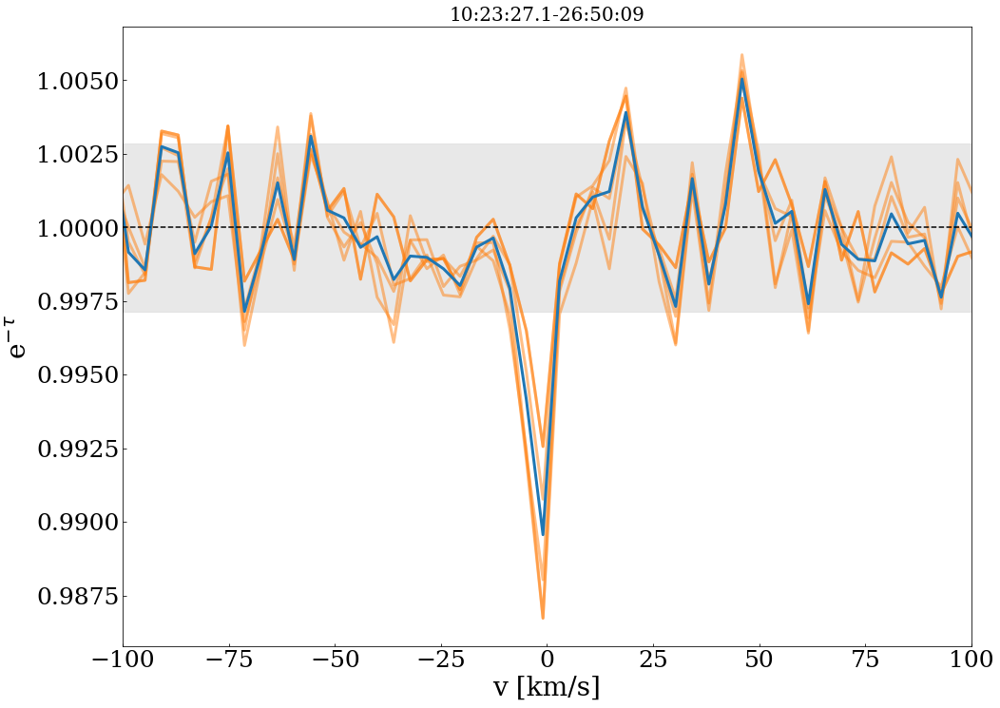

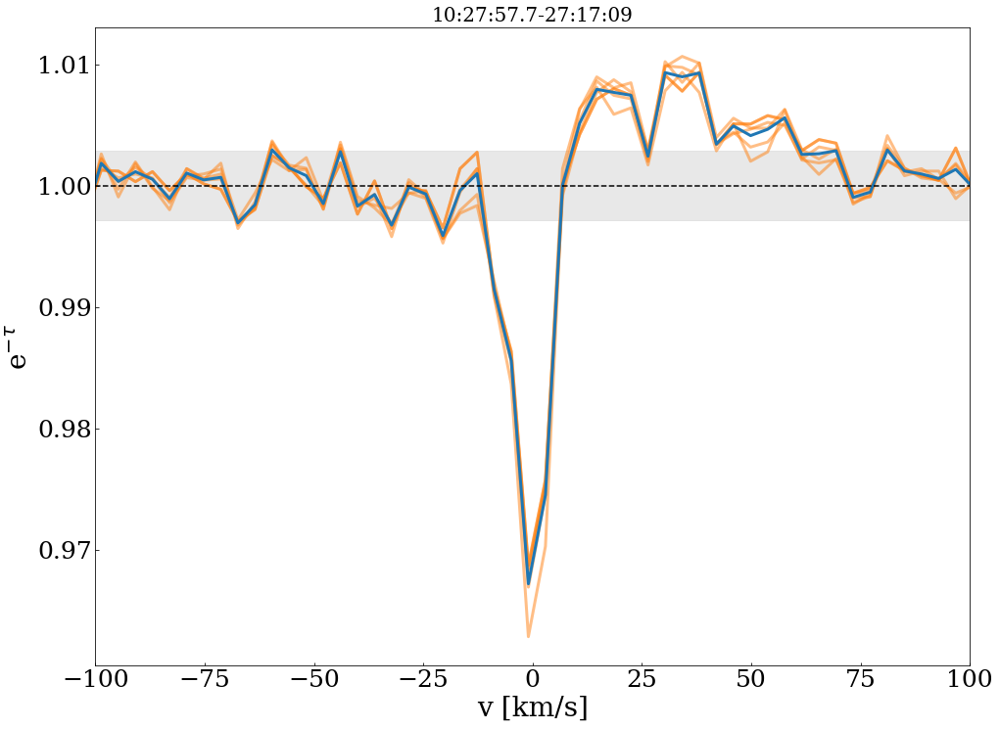

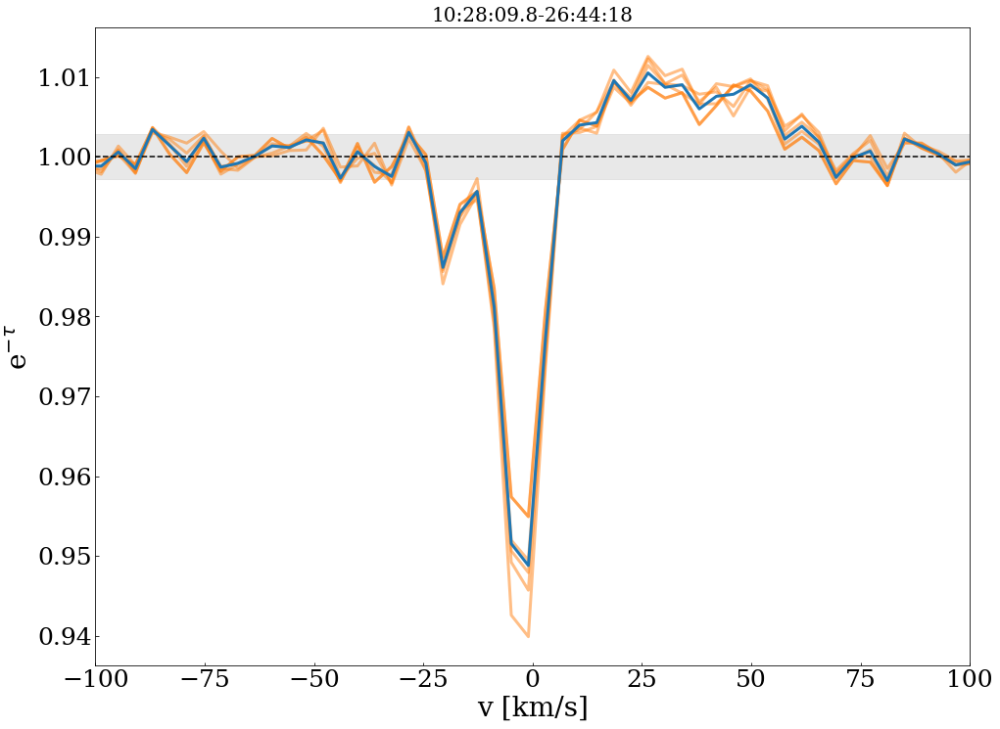

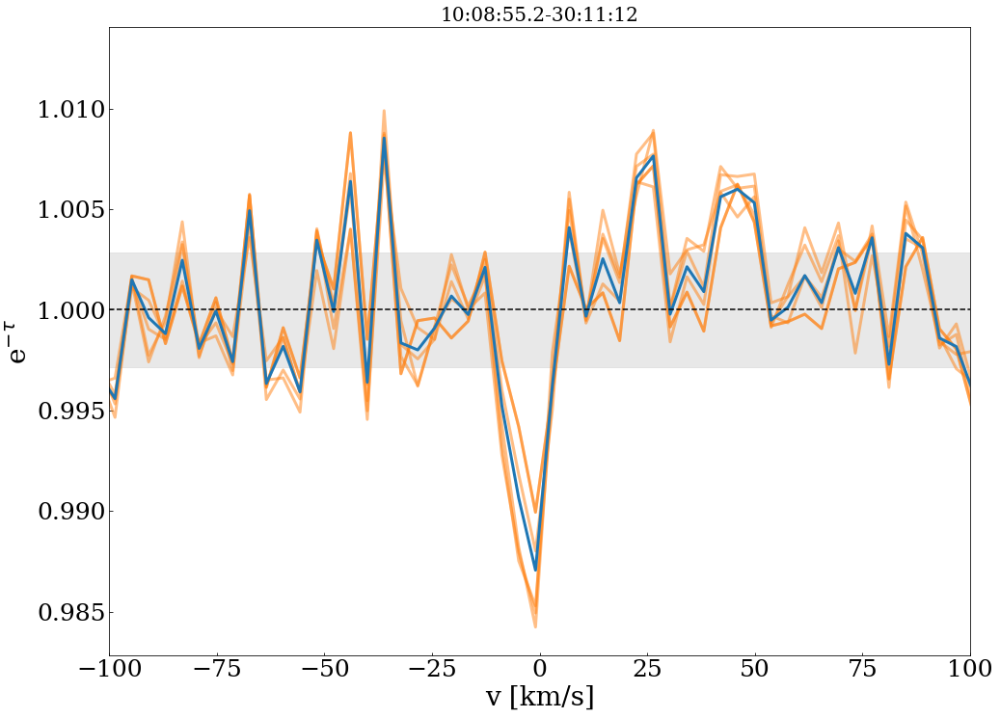

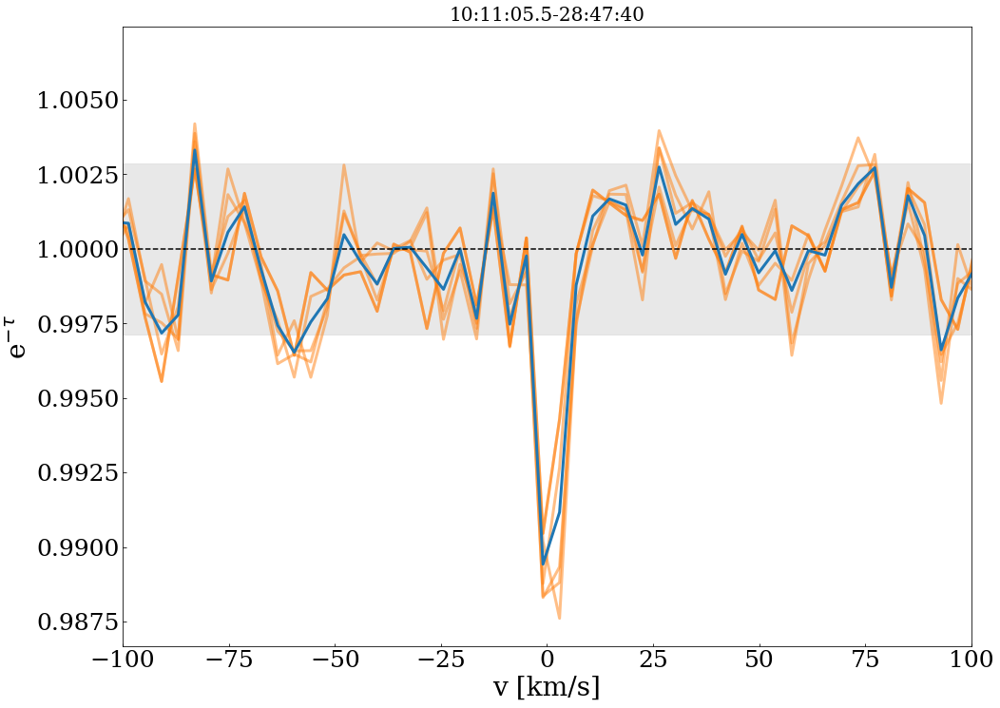

...

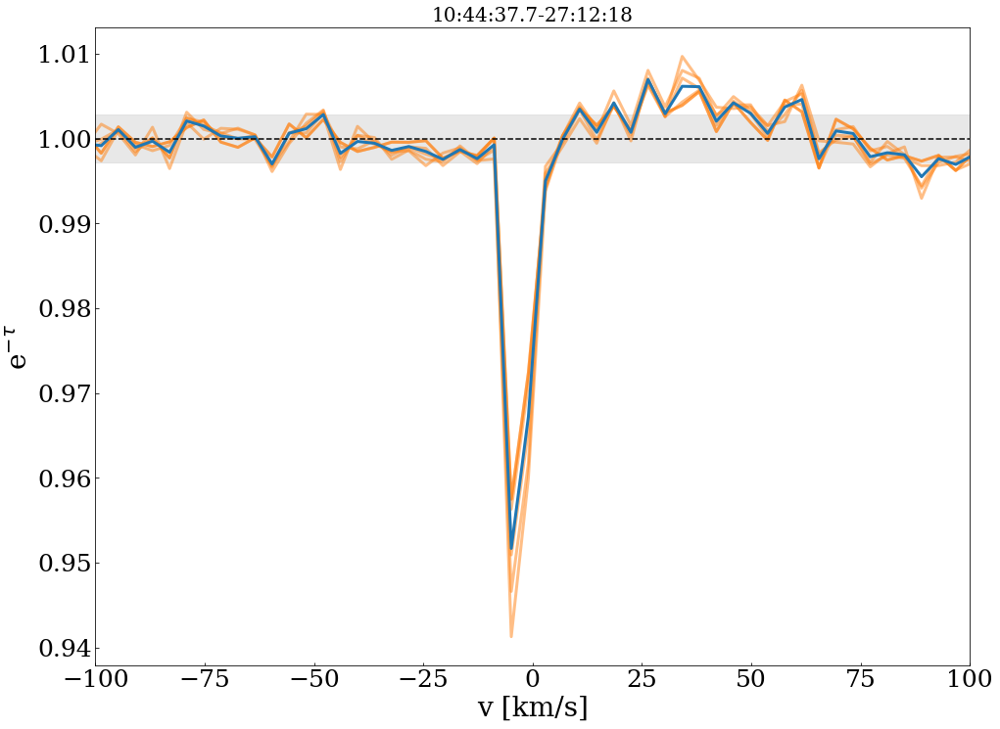

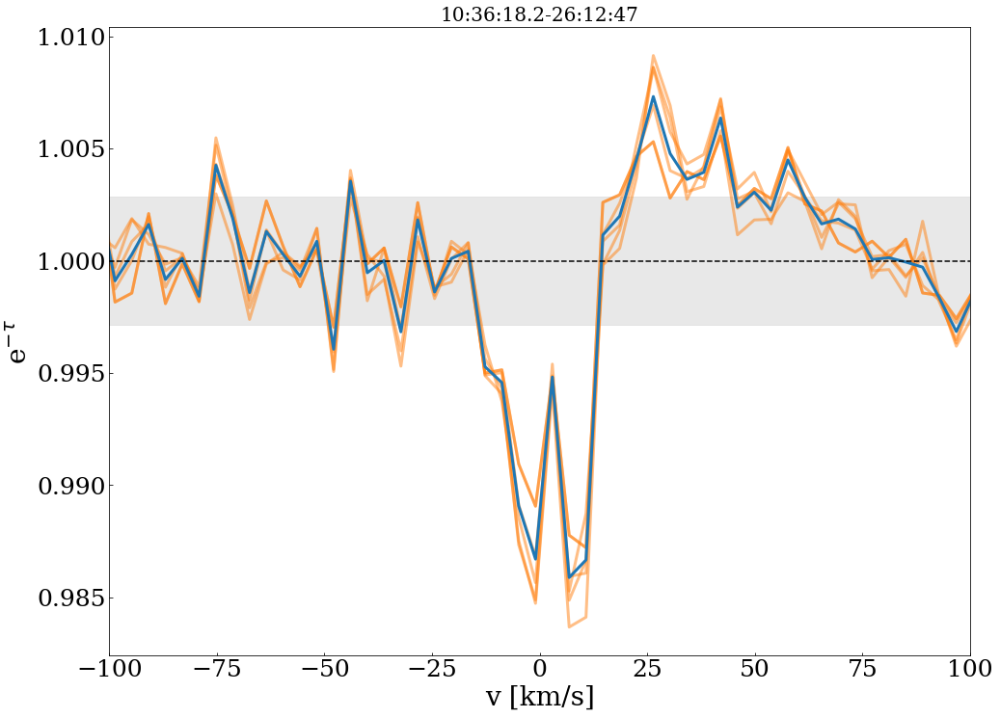

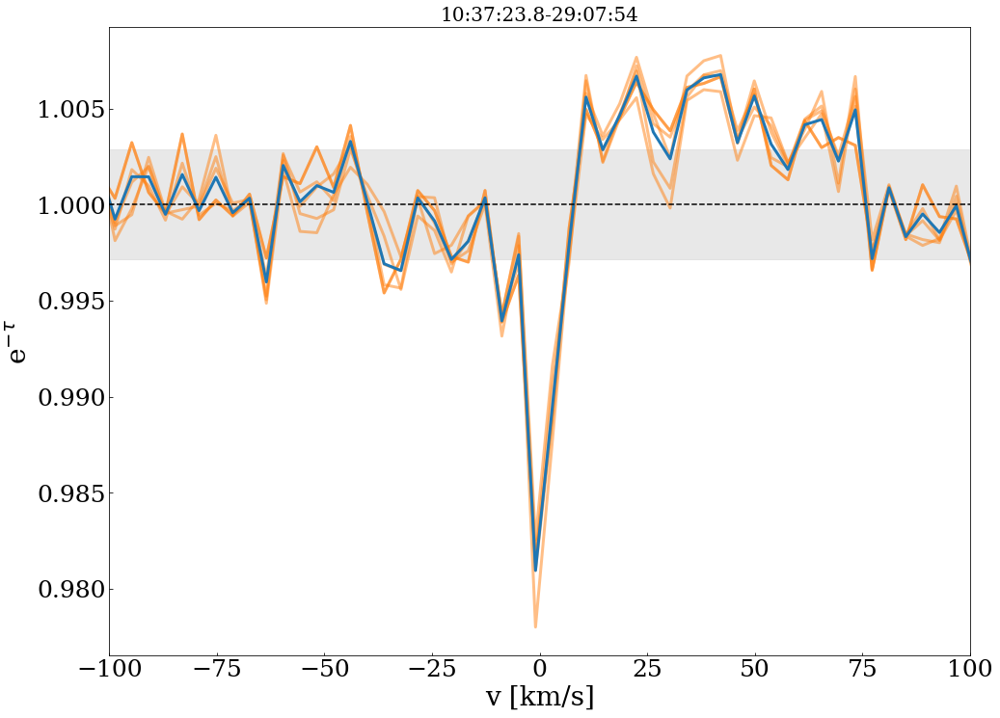

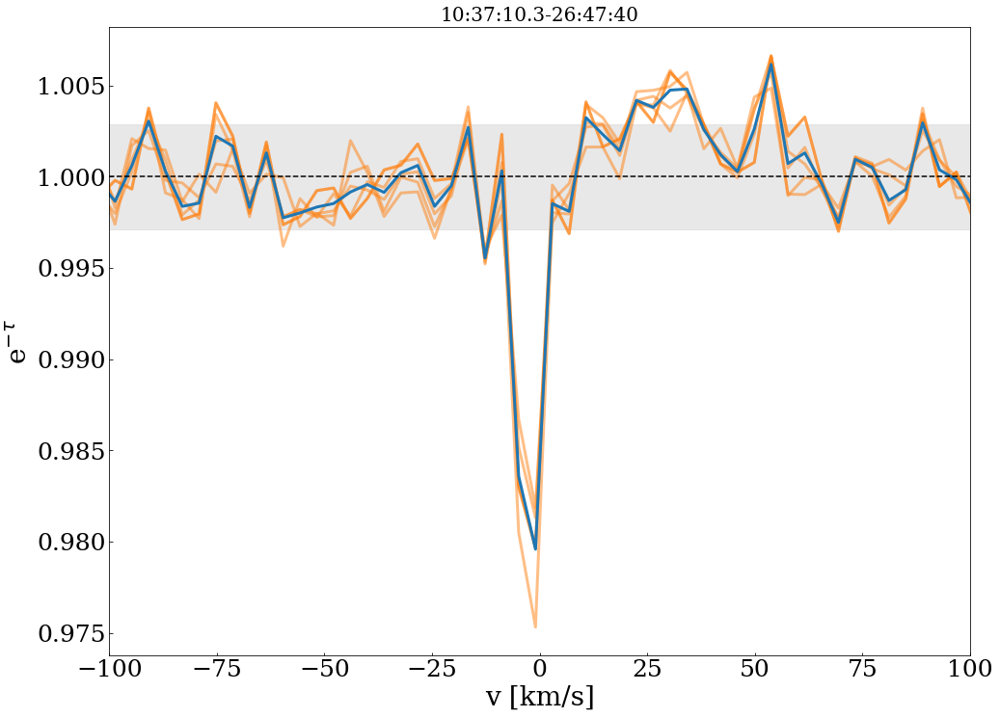

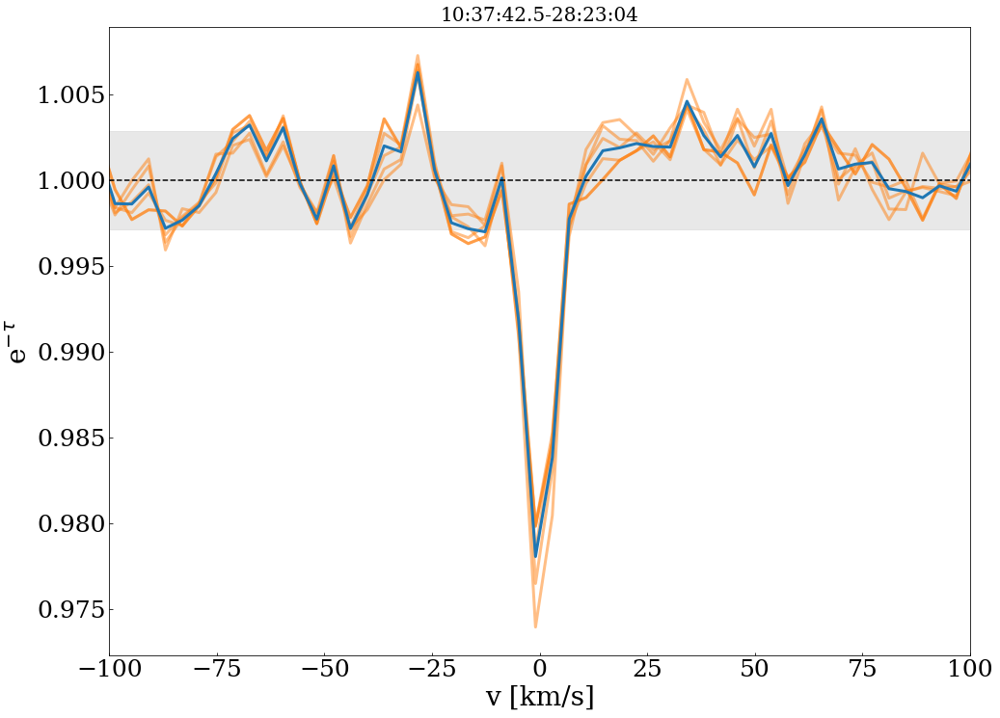

In [22]:
# extract spectra, average some pixels around the detections
# filter for S/N
# make plots

detection = []
rms_abs = []
tau_max = []

for i in range(len(sources)):
    coord = '{} {}'.format(ra[i], dec[i])
    c2 = SkyCoord(coord, unit=(u.hourangle, u.deg))
    pixels_askap = c2.to_pixel(w_askap)
    #print(coord )
    #print(pixels_askap)

    spectrum_askap1 = d_askap[:, 0, int(pixels_askap[1]), int(pixels_askap[0])]  # 10:09:10 -28:55:57
    spectrum_askap2 = d_askap[:, 0, int(pixels_askap[1]-1), int(pixels_askap[0])]
    spectrum_askap3 = d_askap[:, 0, int(pixels_askap[1]-1), int(pixels_askap[0])+1]
    spectrum_askap4 = d_askap[:, 0, int(pixels_askap[1]), int(pixels_askap[0])-1]
    spectrum_askap5 = d_askap[:, 0, int(pixels_askap[1])+1, int(pixels_askap[0])-1]
    spectrum_askap6 = d_askap[:, 0, int(pixels_askap[1])+1, int(pixels_askap[0])-1]
    #spectrum_askap_v2 = d_askap[:, 0, int(pixels_askap[1])-2:int(pixels_askap[1])+3, int(pixels_askap[0])-2:int(pixels_askap[0])+3]
    #spectrum_askap_v2 = np.sum(spectrum_askap_v2, axis=1)
    #spectrum_askap_v2 = np.sum(spectrum_askap_v2, axis=1)/25
    spectrum_askap_v2 = (spectrum_askap1+spectrum_askap2+spectrum_askap3+spectrum_askap4+spectrum_askap5+spectrum_askap6)/6

    #print(spectrum_askap_v2.shape)
    tau_askap = np.log(spectrum_askap +1) * -1.
    rms = np.sqrt(np.mean(spectrum_askap**2))
    rms_abs.append(rms)
    rms_2 = np.sqrt(np.mean(spectrum_askap_v2**2))
    tau_max.append(abs(np.min(spectrum_askap)))
    
    if abs(np.min(spectrum_askap_v2)) > rms_2*4:
        detection.append(i)

        # plot
        fig = plt.figure(figsize=(16, 12))
        ax = fig.add_subplot(111)
        ax.set_title('{}{}'.format(ra[i], dec[i]), fontsize=20)

        plt.plot(vel_askap, spectrum_askap1+1, 'C1', linewidth=3, alpha=0.5 )
        plt.plot(vel_askap, spectrum_askap2+1, 'C1', linewidth=3, alpha=0.5)
        plt.plot(vel_askap, spectrum_askap3+1, 'C1', linewidth=3, alpha=0.5)
        plt.plot(vel_askap, spectrum_askap4+1, 'C1', linewidth=3, alpha=0.5)
        plt.plot(vel_askap, spectrum_askap5+1, 'C1', linewidth=3, alpha=0.5)
        plt.plot(vel_askap, spectrum_askap6+1, 'C1', linewidth=3, alpha=0.5)
        plt.plot(vel_askap, spectrum_askap_v2+1, 'C0', linewidth=3)
        ax.axhspan(1-rms, 1+rms, alpha=0.5, color='lightgrey')
        #plt.title('102809-264418', fontsize=30)
        plt.ylabel(r'e$^{-\tau}$', fontsize=28)
        plt.xlabel("v [km/s]", fontsize=28)
        plt.xlim(-100,100)
        #plt.ylim(0.92,1.02)
        plt.axhline(1, color='k', linestyle='--')
        #plt.legend(fontsize=20)
        ax.tick_params(axis='both', which='major', labelsize=25)
        fig.savefig('./spectra_plots/{}{}_ASKAP_spectra_test_v1.png'.format(ra[i].replace(':',''), dec[i].replace(':','')))

sources['rms_abs'] = rms_abs   
sources['tau_max'] = tau_max
print('4 sigma detections:', len(detection))    

In [12]:
data_test = pd.read_csv('./spectra/104437.7-271218_askap_spectrum.txt', sep='\t')


In [22]:
data_test_2 =  data_test[data_test['velocity'] > -100]

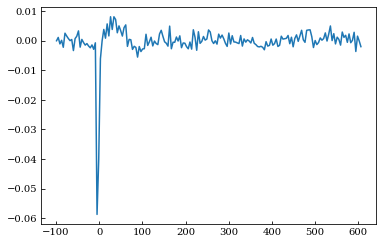

In [23]:
plt.plot(data_test_2['velocity'], data_test_2['Amplitude'])